# **Test notebook for the WongSolver in a single Glasma event**

## Glasma parameters

In [ ]:
import numpy as np

# hbar * c [GeV * fm]
hbarc = 0.197326 

# Simulation box 
L = 10      
N = 512    
tau_sim = 1.2     
DTS = 8     

# Glasma
su_group = 'su2'
Qs = 2        
ns = 50    
factor = 0.8        
g2mu = Qs / factor     
g = np.pi * np.sqrt(1 / np.log(Qs / 0.2))          		
mu = g2mu / g**2          	
ir = 0.1 * g**2 * mu         
uv = 10.0        

## Wong solver parameters

In [2]:
mass = 1.27      
tau_form = 1/(2*mass)*hbarc       
pT = 0    
ntp = 10**5  
representation = 'fundamental'      
boundary = 'periodic'     

## Set environment variables & import relevant modules

In [3]:
import os
os.environ["MY_NUMBA_TARGET"] = "cuda"
os.environ["PRECISION"] = "double"
os.environ["GAUGE_GROUP"] = su_group

# Import relevant modules
import sys
sys.path.append('..')

# Glasma modules
import curraun.core as core
import curraun.mv as mv
import curraun.initial as initial
initial.DEBUG = False

import curraun.su as su
from curraun.numba_target import use_cuda
if use_cuda:
    from numba import cuda

# Wong modules
from curraun import wong
wong.BOUNDARY = boundary
wong.WONG_TO_HOST = True
wong.NUM_CHECK = True
wong.CASIMIRS = True
from curraun.wong import init_mom_toy, init_pos, init_charge

Using CUDA
Using SU(2)
Using double precision
Using double precision
Using double precision


## Initialize the Glasma fields

In [4]:
# Derived parameters
a = L / N
E0 = N / L * hbarc
DT = 1.0 / DTS
formt = int(tau_form / a * DTS)
maxt = int(tau_sim / a * DTS)

# Initialize Glasma fields
s = core.Simulation(N, DT, g)
va = mv.wilson(s, mu=mu / E0, m=ir / E0, uv=uv / E0, num_sheets=ns)
vb = mv.wilson(s, mu=mu / E0, m=ir / E0, uv=uv / E0, num_sheets=ns)
initial.init(s, va, vb)

## Initialize the Wong solver

In [5]:
# Initialize the Wong solver
wong_solver = wong.WongSolver(s, ntp)
x0s, p0s, q0s = np.zeros((ntp, 3)), np.zeros((ntp, 5)), np.zeros((ntp, su.ALGEBRA_ELEMENTS))
masses = mass / E0 * np.ones(ntp)

for i in range(ntp):
    x0, p0, q0 = init_pos(s.n), init_mom_toy('pT', pT / E0), init_charge(representation)
    x0s[i, :], p0s[i, :], q0s[i, :] = x0, p0, q0

wong_solver.initialize(x0s, p0s, q0s, masses)

## Evolve the Glasma fields & solve Wong's equations

In [6]:
from tqdm import tqdm

# Positions and momenta
taus = np.zeros(maxt-formt)
xmu, pmu = np.zeros((maxt-formt, ntp, 3)), np.zeros((maxt-formt, ntp, 5))
p_sq_mean = np.zeros((maxt-formt, 4))
casimirs = np.zeros((maxt-formt, ntp, su.CASIMIRS))
ptau_constraint = np.zeros((maxt-formt, ntp))
q = np.zeros((maxt-formt, ntp, su.GROUP_ELEMENTS))

with tqdm(total=maxt) as pbar:
    for t in range(maxt):
        # Evolve Glasma fields
        core.evolve_leapfrog(s)

        # Solve Wong's equations
        if t>=formt:  
            wong_solver.evolve()
            wong_solver.compute_mom_broad()

            taus[t-formt] = (t-formt)*a/DTS
            xmu[t-formt], pmu[t-formt] = wong_solver.x1.copy()*a, wong_solver.p.copy()*E0
            p_sq_mean[t-formt] = wong_solver.p_sq_mean.copy()*E0**2
            q[t-formt] =  wong_solver.q.copy()

            wong_solver.compute_casimirs(representation)
            casimirs[t-formt] = wong_solver.c.copy()

            wong_solver.compute_ptau_constraint()
            ptau_constraint[t-formt] = wong_solver.ptau_constraint.copy()*E0

        pbar.update(1)

100%|██████████| 491/491 [01:05<00:00,  7.53it/s]


## Save results to file

In [ ]:
import pickle

output = {}
output["tau"], output["xmu"], output["pmu"], output["psq"], output["q"] = taus, xmu, pmu, p_sq_mean, q
output["casimirs"], output["ptauconstraint"] = casimirs, ptau_constraint
output["Qs"], output["hbarc"] = Qs, hbarc

filename = 'test_wong.pickle'
with open(filename, 'wb') as handle:
    pickle.dump(output, handle)

## Read data from file using Julia

In [1]:
using Pickle

output = Pickle.npyload("results/test_wong.pickle")
tau, xmu, pmu, p_sq_mean, q = output["tau"], output["xmu"], output["pmu"], output["psq"], output["q"]
casimirs, ptau_constraint = output["casimirs"], output["ptauconstraint"]
Qs, hbarc = output["Qs"], output["hbarc"]

(2, 0.197326)

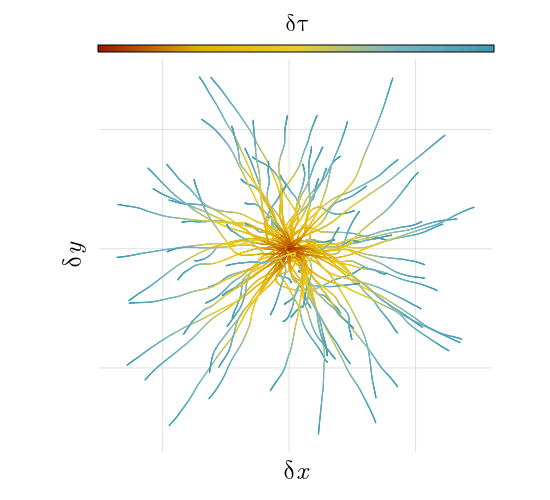

In [2]:
using CairoMakie
using ColorSchemes
using Statistics

wesanderson = ["#3c9bb3", "#78b7c5", "#ebcc2a", "#e1af00", "#9d1700"]
colors = [wesanderson[1], wesanderson[5]]

fig = Figure(resolution = (550, 500), font = "CMU Serif")
ax = Axis(fig[2, 1], aspect = 1,  
        xlabel=L"\delta x", ylabel=L"\delta y",
        rightspinevisible = false, topspinevisible = false, leftspinevisible = false, bottomspinevisible = false,
        leftspinecolor = :gray, bottomspinecolor = :gray,
        xlabelsize = 26, ylabelsize= 26, xticklabelsize=0, yticklabelsize=0,
        xtickalign = 1, xticksize=0, ytickalign=1, yticksize=0, xlabelpadding = -5, 
        # xlabelcolor = :gray, ylabelcolor = :gray, 
        xgridvisible = true, ygridvisible = true)

for i in 1:100
    δx, δy = xmu[:, i, 1].-xmu[1, i, 1], xmu[:, i, 2].-xmu[1, i, 2]
    global line = lines!(ax, δx, δy, linewidth = 1.2, color = tau, colormap = to_colormap(reverse(wesanderson)))
end

cbarline = Colorbar(fig, line, label = L"\delta\tau", labelsize=24, vertical = false, flipaxis = true, 
    ticksize=0, tickalign = 1, ticklabelsize = 0, width = Relative(3.32/4), height = 7)
fig[1, 1] = cbarline
rowgap!(fig.layout, 7)

display(fig)
# save("plots/2d_glasma_spaghetti.png", fig, px_per_unit = 10.0) 
# save("plots/2d_glasma_spaghetti.pdf", fig) 

For the 3D plot, one needs to restart the notebook (```Plots``` and ```CairoMakie``` can't be used in the same script)

In [1]:
using Pickle

output = Pickle.npyload("results/test_wong.pickle")
tau, xmu, pmu, p_sq_mean, q = output["tau"], output["xmu"], output["pmu"], output["psq"], output["q"]
casimirs, ptau_constraint = output["casimirs"], output["ptauconstraint"]
Qs, hbarc = output["Qs"], output["hbarc"]

(2, 0.197326)

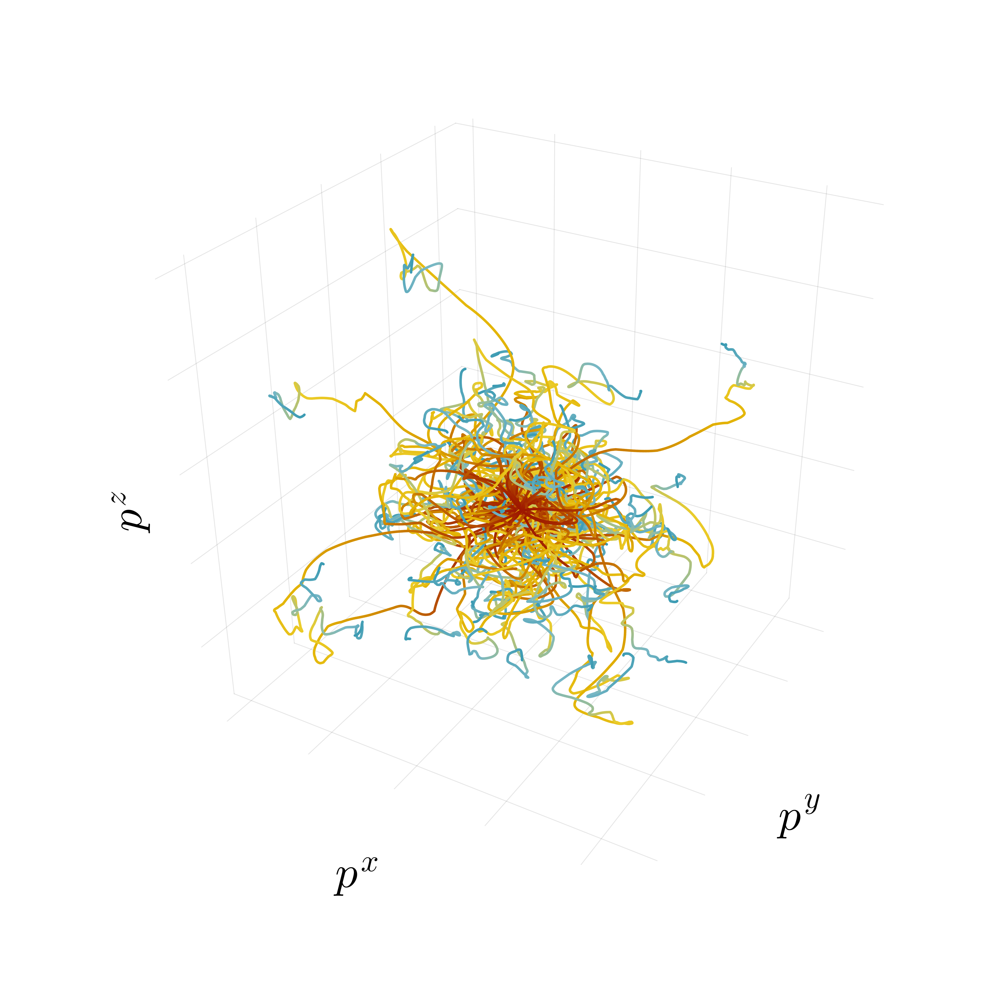

In [2]:
using Plots
# pgfplotsx()
using ColorSchemes
using LaTeXStrings

wesanderson = ["#3c9bb3", "#78b7c5", "#ebcc2a", "#e1af00", "#9d1700"]

for i in 1:100
    if i ==1
        plot(pmu[:, i, 2], pmu[:, i, 3], pmu[:, i, 5], linez = tau, color = cgrad(reverse(wesanderson)), linewidth = 1.5, legend = false)
    else
        plot!(pmu[:, i, 2], pmu[:, i, 3], pmu[:, i, 5], linez = tau, color = cgrad(reverse(wesanderson)), linewidth = 1.5, legend = false)
    end
end

plot!(aspect_ratio=1.0, size=(600,600), dpi=900)
plot!(xlabel=L"p^x", ylabel=L"p^y", zlabel=L"p^z")
plot!(labelfontsize=18, tickfontsize=1, tickfontcolor=:white)

plot!(foreground_color_border=:white)
plot!(tick_dir=:none)

# savefig("plots/3d_glasma_noodles.png")
# savefig("plots/3d_glasma_noodles.pdf")

Restart notebook again

In [1]:
using Pickle

output = Pickle.npyload("results/test_wong.pickle")
tau, xmu, pmu, p_sq_mean, q = output["tau"], output["xmu"], output["pmu"], output["psq"], output["q"]
casimirs, ptau_constraint = output["casimirs"], output["ptauconstraint"]
Qs, hbarc = output["Qs"], output["hbarc"]

(2, 0.197326)

### Temporal constraint

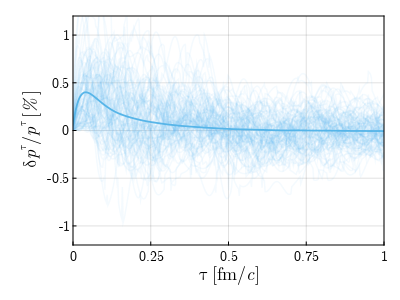

CairoScreen{Cairo.CairoSurfaceBase{UInt32}} with surface:
Cairo.CairoSurfaceBase{UInt32}(Ptr{Nothing} @0x0000000009d52c40, 4000.0, 3000.0)


In [2]:
using CairoMakie
using ColorSchemes
using Statistics

custom_colors = ["#9300d3", "#019d73", "#57b5e8"]
colors = [custom_colors[1], custom_colors[2], custom_colors[3]]
width_line = 1.5

fig = Figure(resolution = (400, 300), font = "CMU Serif")
ax = Axis(fig[1, 1], 
        xlabel=L"\tau\,\mathrm{[fm/}c\mathrm{]}",
        ylabel=L"\delta p^\tau/p^\tau\,[%\,]",
        xlabelsize = 18, ylabelsize= 18, xticklabelsize=14, yticklabelsize=14,
        xtickalign = 1, xticksize=4, ytickalign=1, yticksize=4, xlabelpadding = -5, )

for i in 1:100
    rel_ptau_constraint = (ptau_constraint[:, i] .- pmu[:, i, 1])./pmu[:, i, 1].*100
    lines!(ax, tau, rel_ptau_constraint, linewidth = width_line, color=(colors[3], 0.07))
end

rel_ptau_constraint_all_part = (ptau_constraint .- pmu[:, :, 1])./pmu[:, :, 1].*100
mean_rel_ptau_constraint = vec(mean(rel_ptau_constraint_all_part, dims=2))
lines!(ax, tau, mean_rel_ptau_constraint, linewidth = 1.8, color=colors[3])

xlims!(ax, 0, 1)
ylims!(ax, -1.2, 1.2)
ax.xticks = ([0, 0.25, 0.5, 0.75, 1], ["0", "0.25", "0.5", "0.75", "1"])
ax.yticks = ([-1, -0.5, 0, 0.5, 1], ["-1", "-0.5", "0", "0.5", "1"])

display(fig)
# save("plots/ptau_constraint.pdf", fig) 
save("plots/ptau_constraint.png", fig, px_per_unit = 10.0) 